<!DOCTYPE html>
<html lang="fr">
<head>
    <meta charset="UTF-8">
    <title>Analyse de Trajectoires de Tracking</title>
    <style>
        body {
            font-family: Arial, sans-serif;
        }
        h1 {
            color: skyblue;
            font-size: 24px;
        }
        p, li {
            font-size: 16px;
        }
        .green-text{
            color: DarkSeaGreen;
        }
    </style>
</head>
<body>
    <h1>Analyse de Trajectoires de Tracking</h1>
    <p>Ce code d'analyse permet de traiter les données issues du tracking pour extraire et étudier statistiquement les trajectoires pertinentes. Le processus est structuré comme suit :</p>
    <ol>
        <li><strong class="green-text">Récupération des trajectoires :</strong> Collecte de toutes les trajectoires issues des différentes manipulations.</li>
        <li><strong class="green-text">Pré-analyse :</strong> Examen initial des trajectoires pour déterminer celles à conserver pour l'analyse approfondie.</li>
        <li><strong class="green-text">Analyse statistique :</strong> Application de méthodes statistiques aux trajectoires conservées. Les données peuvent être séparées en deux populations pour un traitement spécifique si nécessaire.</li>
    </ol>
    <p>L'analyse se concentre sur les paramètres suivants :</p>
    <ul>
        <li>Angle entre les directions successives d'une particule entre chaque intervalle de temps.</li>
        <li>Vitesses moyennes et instantanées des particules.</li>
        <li>Variation de la vitesse en fonction du temps d'incubation.</li>
        <li>Effet potentiel de la densité de cellules sur la motilité.</li>
    </ul>
</body>
</html>


##
<center><span style="color: seagreen; font-size: 50px; font-style: bold">Chargement et préparation des données.</span></center>
<span style="color: skyblue; font-size: 20px; font-style: bold">Chargement des librairies.</span>

In [2]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Wed Mar  1 12:46:56 2023.

@author: souchaud
"""

import os
import time
import math
import pandas as pd
import numpy as np
import imageio.v2 as imageio
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from matplotlib import colormaps
from cycler import cycler
import trackpy as tp
import functions_analyze as lib
import warnings
import importlib
from colorama import init
from typing import List, Optional, Union, Any, Dict, Tuple

# Reload custom library
importlib.reload(lib)

# Initialize colorama
init(autoreset=True)

# Suppress specific warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore", category=FutureWarning)

# Set default matplotlib style
plt.style.use('default')

<span style="color: skyblue; font-size: 20px; font-style: bold">Paramètres de graphs.</span>

In [3]:
# Update matplotlib parameters
plt.rcParams.update({
    "figure.facecolor": (0.12, 0.12, 0.12, 1),
    "axes.facecolor": (0.12, 0.12, 0.12, 1),
    "axes.edgecolor": "white",
    "axes.labelcolor": "white",
    "xtick.color": "white",
    "ytick.color": "white",
    "grid.color": "gray",
    "text.color": "white",
    "axes.titlesize": 16,
    "axes.titleweight": "bold",
    "axes.labelsize": 14,
    "axes.labelweight": "medium",
    "legend.fontsize": 12,
    "lines.linewidth": 2,
    "lines.markersize": 8,
    "font.size": 12,
    "font.family": "sans-serif",
    "font.sans-serif": ["Arial", "Helvetica", "DejaVu Sans"],
    "axes.prop_cycle": cycler(color=["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728"]),
})


##
<span style="color: skyblue; font-size: 20px; font-style: bold">Initialisation des variables et constantes de travail..</span>

In [4]:
# Set initial time
INITIAL_TIME = time.time()

# Experiment parameters
TIME_FRAME = 15
SIZE_PIX = 0.637
FPS = 1 / TIME_FRAME

# File to study
file_name = 'filtered_final'
N_FRAME_MIN_STUDY = 200

# Study parameters
ROLLING_MEAN = False
PIXELISATION = False
TIME_FRAME_STUDY = False
DRIFT = False

# Plot parameters
IMG_TYPE = 'svg'
ALPHA = 0.5
LINEWIDTH = 0.1
COLOR_SUP = 'blue'
COLOR_INF = 'red'
color_sup_inf = (COLOR_SUP, COLOR_INF)

##
<span style="color: skyblue; font-size: 20px; font-style: bold">Définition des path et dossiers de travails / enregistrements.</span>

<span style="color: skyblue; font-size: 20px; font-style: bold">Conditions des manips étudiées.</span>

<span style="color: skyblue; font-size: 20px; font-style: bold">Défintions et créations des différents dossiers d'enregistrements.</span>

In [5]:
# General paths
GENERAL_PATH = '/Users/souchaud/Desktop/Analyses/'
GENERAL_PATH_PICTURES = '/Users/souchaud/Desktop/A_analyser/'

# Condition
CONDITION_simple = 'CytoOne_SorC_10x'
CONDITION = f'{CONDITION_simple}_results_tracking'

# Get list of experiments
PATHWAY_EXPERIMENT = [f for f in os.listdir(GENERAL_PATH + CONDITION)
                      if os.path.isdir(os.path.join(GENERAL_PATH + CONDITION, f))]

# Update experiment paths
PATHWAY_EXPERIMENT = [os.path.join(GENERAL_PATH, CONDITION, elem, 'mosaic')
                      for elem in PATHWAY_EXPERIMENT]

# Path to save pictures
path_save_pic = os.path.join(GENERAL_PATH, f'résultats_{CONDITION}_All')

# Create directory if it doesn't exist
os.makedirs(path_save_pic, exist_ok=True)
os.chdir(path_save_pic)


In [6]:
conditions_to_values = {
    'ASMOT184': 0, 'ASMOT185': 0, 'ASMOT186': 0, 'ASMOT187': 24.00,
    'ASMOT188': 26.50, 'ASMOT189': 30.00, 'ASMOT190': 47.75, 'ASMOT191': 51.33,
    'ASMOT192': 53.50, 'ASMOT193': 48.67, 'ASMOT194': 50.17, 'ASMOT195': 53.00,
    'ASMOT196': 72.92, 'ASMOT197': 74.67, 'ASMOT198': 0.00, 'AMOT199': 4.00,
    'ASMOT200': 5.50, 'ASMOT201': 23.00, 'ASMOT202': 24.50, 'ASMOT203': 26.33,
    'ASMOT204': 27.83, 'ASMOT205': 29.25, 'ASMOT206': 47.00, 'ASMOT207': 1.00,
    'ASMOT208': 1.67, 'ASMOT209': 4.92,
}

##
<center><span style="color: Crimson; font-size: 30px; font-style: bold">Lecture des données expériementales.</span></center>

<span style="color: skyblue; font-size: 20px">On décide de travailler que sur un certain nombre de frame. Ici je décide de travailler sur les 340 première frames pour normaliser les expériences. 
Donc la cellules doit être suivi sur N_MIN_STUDY sur les 340 premières frames. </span>

<span style="color: skyblue; font-size: 20px">Application de fonctions pour moyenne flissante et pixelisation et étude d'une frame sur x </span>

In [7]:
# Read HDF5 data
importlib.reload(lib)
DATA = lib.read_hdf5_all(
    pathway_experiment=PATHWAY_EXPERIMENT,
    name_file=file_name,
    nbr_frame_min=N_FRAME_MIN_STUDY,
    condition=CONDITION,
    drift=DRIFT,
    search_range=20,
    memory=5
)

# Sort DATA by 'frame'
DATA.sort_values(by='frame', inplace=True)

# Filter DATA
print("Nombre de particules avant tri: ", DATA['particle'].nunique())
DATA = DATA[DATA['frame'] < 340]

# Keep particles with sufficient frames
DATA = DATA.groupby('particle').filter(lambda x: len(x) >= N_FRAME_MIN_STUDY)
print("Nombre de particules après tri: ", DATA['particle'].nunique())

# Apply optional data transformations
if ROLLING_MEAN:
    DATA = lib.rolling_mean(datas=DATA, roll=3)
if PIXELISATION:
    DATA = lib.pixelisation(datas=DATA, size_pix=SIZE_PIX)
if TIME_FRAME_STUDY:
    DATA, TIME_FRAME = lib.keep_nth_image(traj=DATA, n=N_FRAME_MIN_STUDY, time_frame=TIME_FRAME)

# Calculate instant velocities
DATA['time (min)'] = DATA['frame'] * TIME_FRAME / 60
DATA = lib.vit_instant_new(traj=DATA, lag_time=TIME_FRAME, pix_size=SIZE_PIX, triage=1)

DATA['time to incubation (hours)'] = DATA['experiment'].map(conditions_to_values).fillna(0.0)

['/Users/souchaud/Desktop/Analyses/CytoOne_SorC_10x_results_tracking/2024_10_16_ASMOT192_AX3_2024_P3_10x_CytoOne_SorC_1410-10h30DansSorCpuisHL5le1510a10h10_1610_16h00/mosaic/filtered_final.hdf5']
ASMOT192  :  105
['/Users/souchaud/Desktop/Analyses/CytoOne_SorC_10x_results_tracking/2024_11_07_ASMOT202_AX3_2024_P2_10x_CytoOne_SorC_0611-10h00-0711-10h30/mosaic/filtered_final.hdf5']
ASMOT202  :  217
No HDF5 files found in /Users/souchaud/Desktop/Analyses/CytoOne_SorC_10x_results_tracking/2024_10_17_ASMOT193_AX3_2024_P3_10x_CytoOne_SorC_1410-10h30DansSorCpuisHL5le1510a10h10_1710_11h10/mosaic. Skipping to next directory.
['/Users/souchaud/Desktop/Analyses/CytoOne_SorC_10x_results_tracking/2024_11_07_ASMOT205_AX3_2024_P2_10x_CytoOne_SorC_0611-10h00-0711-15h15/mosaic/filtered_final.hdf5']
ASMOT205  :  534
No HDF5 files found in /Users/souchaud/Desktop/Analyses/CytoOne_SorC_10x_results_tracking/2024_11_07_ASMOT210_AX3_2024_P5_10x_CytoOne_SorC_1311-11h05-1311-17h20/mosaic. Skipping to next direc

###
<center><span style="color: skyblue; font-size: 20px"> Mean Mass and size plot </span></center>

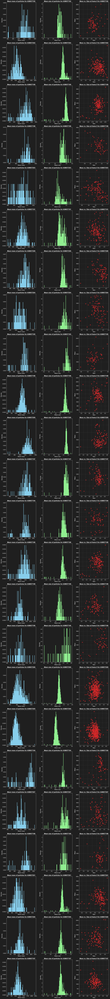

In [8]:
# Plot Mean Mass and Size per Manipulation
def plot_mean_mass_size(DATA, path_save_pic, IMG_TYPE):
    manips = DATA['experiment'].unique()
    num_manips = len(manips)
    fig = plt.figure(figsize=(16, 6 * num_manips))
    gs = gridspec.GridSpec(num_manips, 3, fig)
    colors = ['skyblue', 'lightgreen', 'salmon']
    for i, manip in enumerate(manips):
        data_manip = DATA[DATA['experiment'] == manip]
        mass_means = data_manip.groupby('particle')['mass'].mean()
        size_means = data_manip.groupby('particle')['size'].mean()
        filtered_data = data_manip[data_manip['frame'] == 0]

        ax1 = fig.add_subplot(gs[i, 0])
        ax1.hist(mass_means, bins=100, color=colors[0], density=True)
        ax1.set_title(f"Mean mass of particles for {manip}")
        ax1.set_xlabel("Mean mass")
        ax1.set_ylabel("Density")

        ax2 = fig.add_subplot(gs[i, 1])
        ax2.hist(size_means, bins=100, color=colors[1], density=True)
        ax2.set_title(f"Mean size of particles for {manip}")
        ax2.set_xlabel("Mean size")
        ax2.set_ylabel("Density")

        ax3 = fig.add_subplot(gs[i, 2])
        ax3.scatter(filtered_data['size'], filtered_data['mass'], c="#d62728", edgecolors="#d62728", alpha=0.7)
        ax3.set_title(f"Mass vs. Size at frame 0 for {manip}")
        ax3.set_xlabel("Size")
        ax3.set_ylabel("Mass")
        ax3.grid(True, linestyle="--", alpha=0.5)

    plt.tight_layout()
    plt.show()
    fig.savefig(os.path.join(path_save_pic, f"Mean_Mass_Size_manip.{IMG_TYPE}"), format=IMG_TYPE)

plot_mean_mass_size(DATA, path_save_pic, IMG_TYPE)


###
<center><span style="color: skyblue; font-size: 20px"> plot total path for each partciel in each experiment (histograms) </span></center>

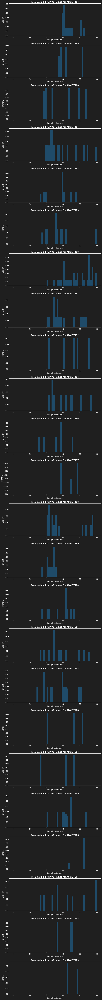

In [9]:
# Calculate total path for the first N frames
path_data = lib.calculate_total_path_first_frames(DATA, first_n_frames=100)

# Plot Total Path in First 100 Frames per Experiment
def plot_total_path(path_data):
    grouped = path_data.groupby('experiment')
    n_experiments = len(grouped)
    fig, axes = plt.subplots(nrows=n_experiments, figsize=(10, 4 * n_experiments))
    axes = axes if n_experiments > 1 else [axes]
    for (experiment, group), ax in zip(grouped, axes):
        ax.hist(group['total_path_first_n'], bins=50, range=[0, 100], density=True, alpha=0.5)
        ax.set_title(f"Total path in first 100 frames for {experiment}")
        ax.set_xlabel('Length path (μm)')
        ax.set_ylabel('Density')
    plt.tight_layout()
    plt.savefig(os.path.join(path_save_pic, f"Total path in first 100 frames.{IMG_TYPE}"), format=IMG_TYPE)
    plt.show()

plot_total_path(path_data)

###
<center><span style="color: skyblue; font-size: 20px"> Creation des traj centrées / distance cumulée / IMSD </span></center>


In [10]:
# Center trajectories
DATA.reset_index(inplace=True)
DATA = lib.center(traj=DATA)

print(f"\n\nTemps de préparation des données pour {CONDITION}: {time.time() - INITIAL_TIME} sec\n\n")

# Calculate total and cumulative displacement
DATA, start_end = lib.length_displacement(traj=DATA, size_pix=SIZE_PIX)

# Compute MSD and cutoff
DATA2 = DATA.copy()
DATA2['frame'] = pd.factorize(DATA2['frame'])[0]
IMSD = tp.imsd(traj=DATA2, mpp=SIZE_PIX, fps=FPS, max_lagtime=200, statistic='msd')



Temps de préparation des données pour CytoOne_SorC_10x_results_tracking: 15.972018957138062 sec




###
<center><span style="color: skyblue; font-size: 20px"> Premier fit pour exclure certaines traj </span></center>

Minimum local:  0.2000053567358101
# negative slope 17


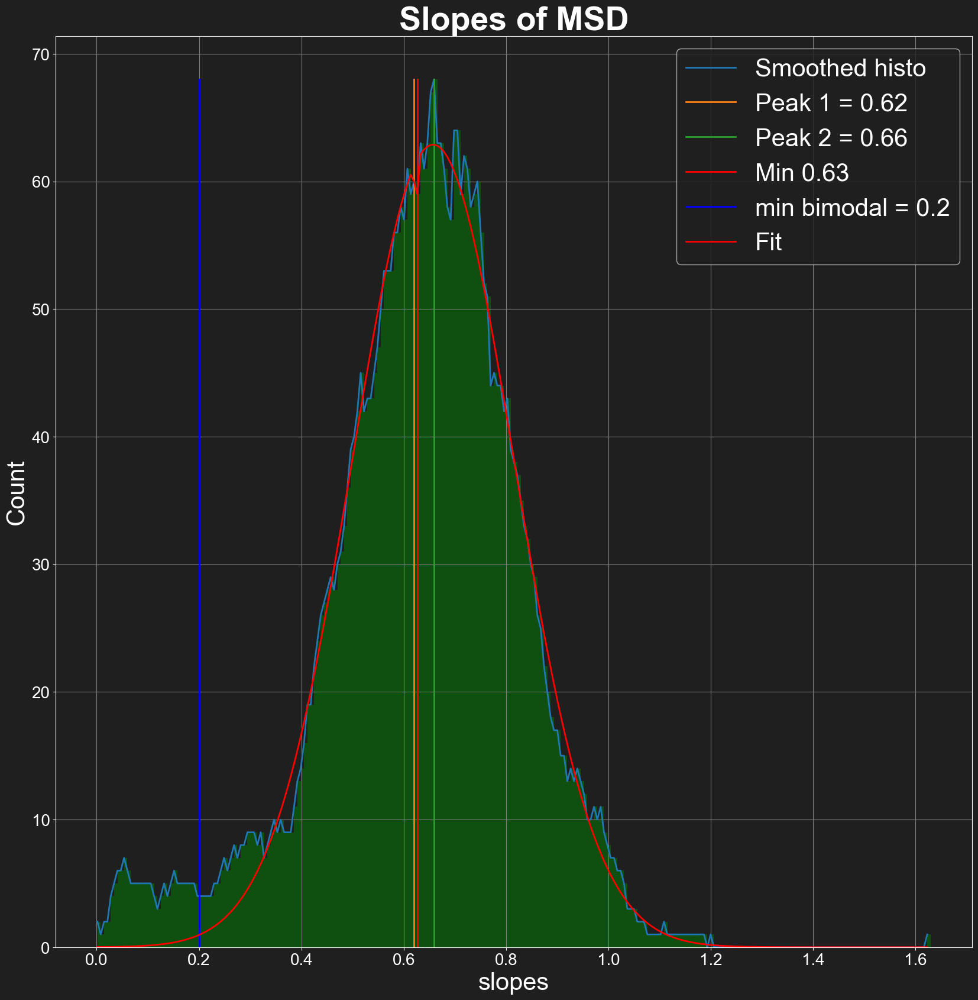

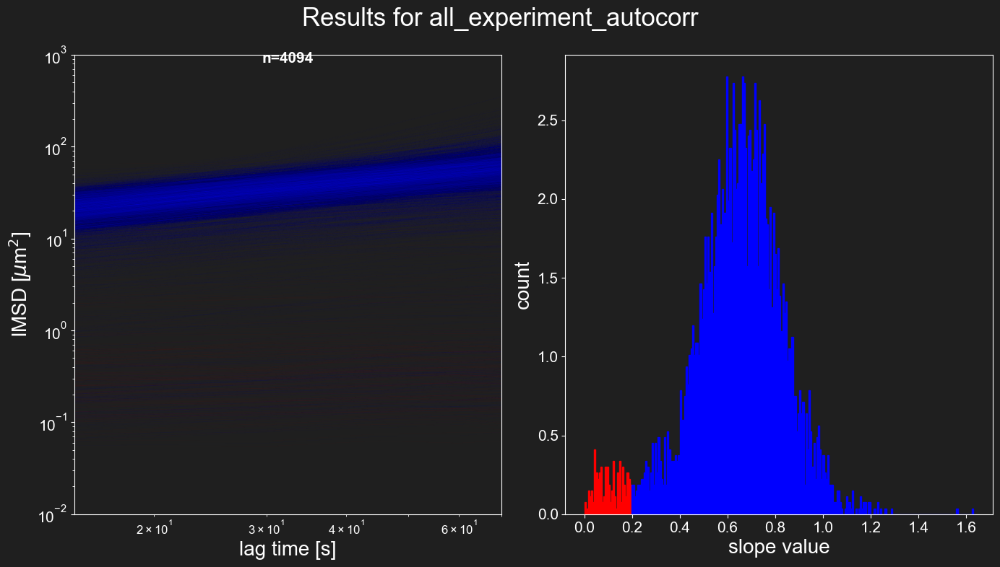

In [11]:
# Trajectory clustering with fit and defining a cutoff
LAG_TIME_FIT = 5
importlib.reload(lib)
COEF_INF, COEF_SUP, PART_COEF_INF, PART_COEF_SUP, CUTOFF = lib.traj_clustering_with_fit_cutoff(
    DATA2, imsd=IMSD, hist=True, lag_time_fit=LAG_TIME_FIT, micronperpixel=SIZE_PIX,
    fps=FPS, binsize=250, peak_height=50, peak_width=1, save=True, pathway_fig=path_save_pic,
    name='all_experiment_autocorr', img_type=IMG_TYPE, plot=True, color_sup_inf=color_sup_inf,
    cutoff_default=0.20
)

# Keep only particles above cutoff
DATA = DATA[DATA['particle'].isin(PART_COEF_SUP)]

###
<center><span style="color: skyblue; font-size: 20px"> définitions des temps de manip </span></center>

In [ ]:
# Plot Number of Particles per Frame for All Experiments in One Graph
def plot_nbr_particles_per_frame_combined(DATA, path_save_pic, IMG_TYPE):
    """
    Plot the number of unique particles per frame for all experiments on a single graph with different colors.

    Parameters:
    - DATA (DataFrame): The input data containing tracking information.
    - path_save_pic (str): The path where the plot will be saved.
    - IMG_TYPE (str): The format for saving the plot (e.g., 'png', 'jpg').
    """
    experiments = DATA['experiment'].unique()

    # Generate a colormap with enough unique colors for all experiments
    colormap = plt.colormaps['tab20']  # Use the modern colormap API
    colors = [colormap(i / len(experiments)) for i in range(len(experiments))]

    plt.figure(figsize=(12, 13))
    for i, exp in enumerate(experiments):
        # Group data by time and calculate the number of unique particles per frame
        nbr_part_per_frame = DATA[DATA['experiment'] == exp].groupby('time (min)')['particle'].nunique()
        plt.plot(
            nbr_part_per_frame.index, nbr_part_per_frame.values, 
            label=exp, color=colors[i], alpha=1, linewidth=0.8
        )

    # Add labels, legend, and title
    plt.title('Number of Particles per Frame for All Experiments', fontsize=14)
    plt.xlabel('Time (min)', fontsize=12)
    plt.ylabel('Number of Particles', fontsize=12)
    plt.legend(title="Experiments", bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=10)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()

    # Save and show the plot
    fig_path = os.path.join(path_save_pic, f"Nbr_particle_per_Frame_combined.{IMG_TYPE}")
    plt.savefig(fig_path, format=IMG_TYPE, bbox_inches='tight')
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction
plot_nbr_particles_per_frame_combined(DATA, path_save_pic, IMG_TYPE)

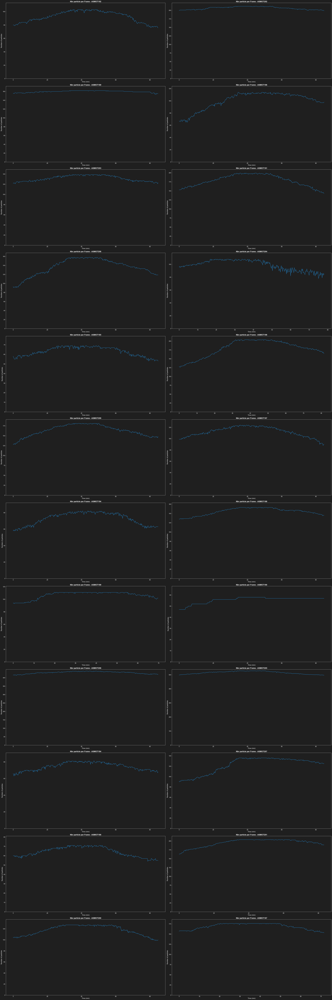

In [ ]:
# # Plot Number of Particles per Frame per Experiment
# def plot_nbr_particles_per_frame(DATA, path_save_pic, IMG_TYPE):
#     experiments = DATA['experiment'].unique()
#     n_cols = 2
#     n_rows = (len(experiments) + n_cols - 1) // n_cols
#     fig, axs = plt.subplots(n_rows, n_cols, figsize=(20 * n_cols, 10 * n_rows))
#     axs = axs.flatten()
#     for i, exp in enumerate(experiments):
#         nbr_part_per_frame = DATA[DATA['experiment'] == exp].groupby('time (min)')['particle'].nunique()
#         ax = axs[i]
#         ax.plot(nbr_part_per_frame.index, nbr_part_per_frame.values)
#         ax.set_ylim([0, nbr_part_per_frame.max() + 10])
#         ax.set_title(f'Nbr particle per Frame - {exp}')
#         ax.set_xlabel('Time (min)')
#         ax.set_ylabel('Number of particles')
#     for ax in axs[len(experiments):]:
#         ax.axis('off')
#     plt.tight_layout()
#     plt.savefig(os.path.join(path_save_pic, f"Nbr_particle_per_Frame_manip_par_manip.{IMG_TYPE}"), format=IMG_TYPE)
#     plt.show()

# plot_nbr_particles_per_frame(DATA, path_save_pic, IMG_TYPE)

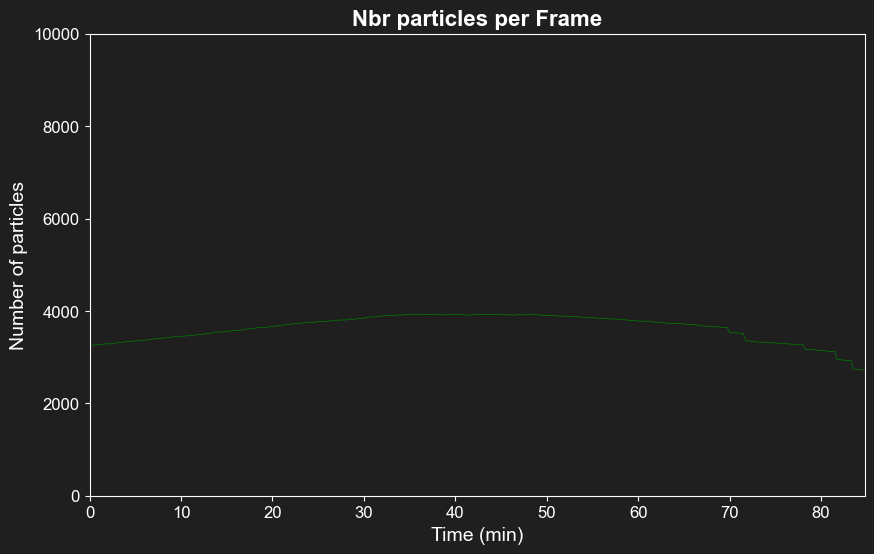

Figure saved at: /Users/souchaud/Desktop/Analyses/résultats_CytoOne_SorC_10x_results_tracking_All/Nbr_particles_per_Frame.svg


In [13]:
# Plot Number of Particles per Frame
nbr_part_per_frame = DATA.groupby('time (min)')['particle'].nunique()
lib.plot_datas(
    x_values=nbr_part_per_frame.index,
    y_values=nbr_part_per_frame.values,
    title='Nbr particles per Frame',
    x_label='Time (min)', y_label='Number of particles',
    x_lim=[0, nbr_part_per_frame.index.max()], y_lim=[0, 10000],
    save=True, path_save_pic=path_save_pic, img_type=IMG_TYPE
)

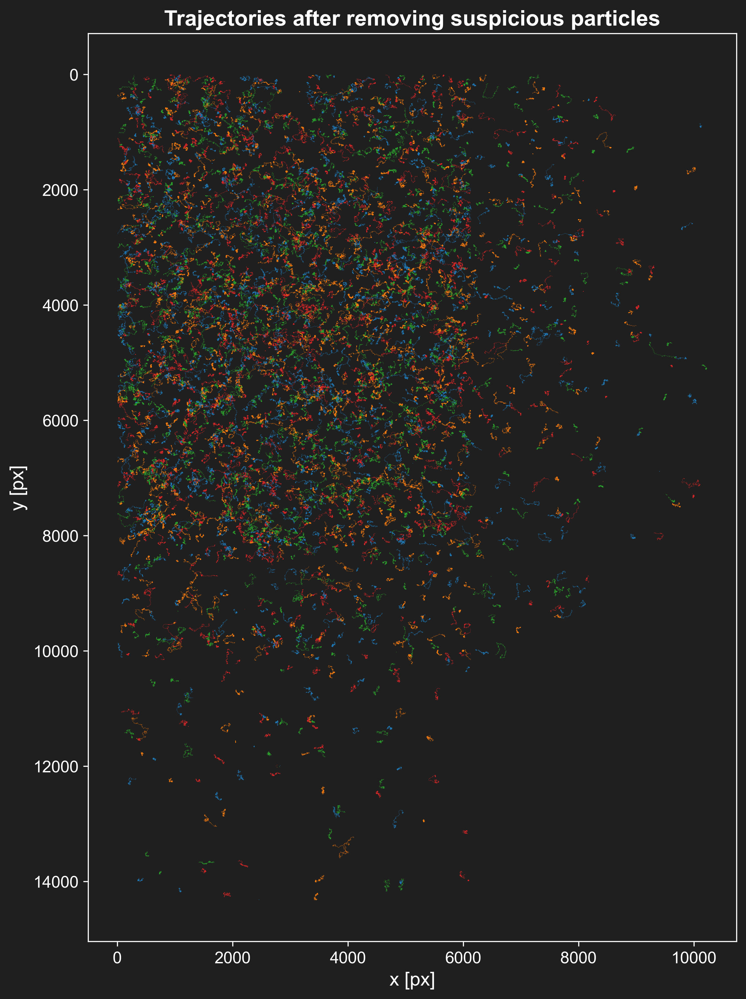

In [14]:
# Plot Trajectories after Removing Suspicious Particles
fig, axis = plt.subplots(figsize=(12, 12), dpi=300)
axis.set_aspect('equal', 'box')
plt.title('Trajectories after removing suspicious particles', fontsize=16)
tp.plot_traj(DATA, label=False, ax=axis)
for line in axis.get_lines():
    line.set_linewidth(0.1)
plt.show()
fig.savefig(os.path.join(path_save_pic, f'Trajectories_after_removing_suspicious_particles.{IMG_TYPE}'),
            format=IMG_TYPE, dpi=300, bbox_inches='tight')

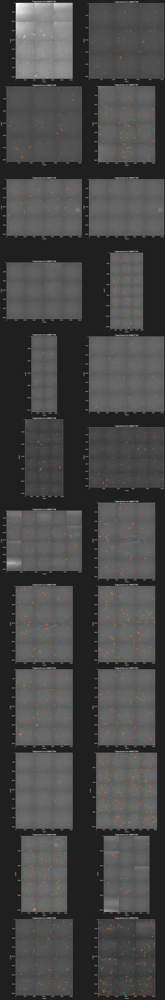

In [15]:
# Plot Trajectories on Original Frames
def plot_trajectories_on_frames(DATA, path_save_pic, GENERAL_PATH_PICTURES, CONDITION_simple):
    image_path = os.path.join(GENERAL_PATH_PICTURES, f"{CONDITION_simple}_faits")
    plot_exp = DATA.groupby('experiment')
    num_experiments = len(plot_exp)
    num_cols = 2
    num_rows = (num_experiments + num_cols - 1) // num_cols
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, num_rows * 10))
    axes = axes.flatten()
    for ax, (exp_name, exp_data) in zip(axes, plot_exp):
        exp_directories = []
        for dirpath, dirnames, _ in os.walk(image_path):
            for dirname in dirnames:
                if exp_name in dirname:
                    full_path = os.path.join(dirpath, dirname)
                    exp_directories.append(full_path)
        if exp_directories:
            image_path_directory = os.path.join(exp_directories[0], 'mosaic', 'mosaic_total_0.tif')
            frame = imageio.imread(image_path_directory)
            ax.set_aspect('equal', 'box')
            ax.set_title(f'Trajectories for {exp_name}')
            tp.plot_traj(exp_data, superimpose=frame, label=False, ax=ax)
        else:
            print(f"No directory found for {exp_name}")
            ax.axis('off')
    plt.tight_layout()
    plt.show()
    fig.savefig(os.path.join(path_save_pic, 'trajectories_on_frame_all_experiment.pdf'), format='pdf')

plot_trajectories_on_frames(DATA, path_save_pic, GENERAL_PATH_PICTURES, CONDITION_simple)

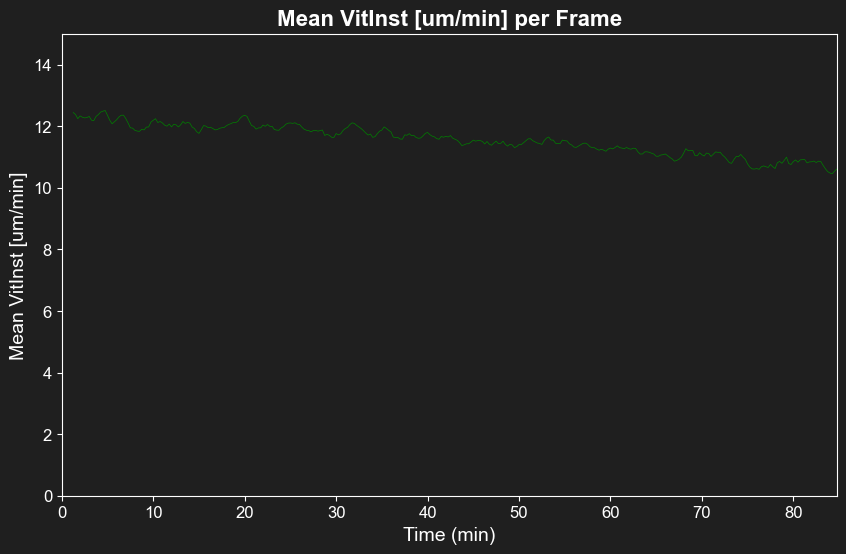

Figure saved at: /Users/souchaud/Desktop/Analyses/résultats_CytoOne_SorC_10x_results_tracking_All/Mean_VitInst_[um_min]_per_Frame.svg


In [16]:
# Plot Mean Instantaneous Speed per Frame
mean_VitInst_per_frame = DATA.groupby('time (min)')['VitInst [um/min]'].mean()
mean_VitInst_per_frame = mean_VitInst_per_frame.rolling(5).mean().dropna()

# Appel avec vérification du répertoire
lib.plot_datas(
    x_values=mean_VitInst_per_frame.index,
    y_values=mean_VitInst_per_frame.values,
    title='Mean VitInst [um/min] per Frame',
    x_label='Time (min)', y_label='Mean VitInst [um/min]',
    x_lim=[0, mean_VitInst_per_frame.index.max()], y_lim=[0, 15],
    save=True, path_save_pic=path_save_pic, img_type=IMG_TYPE
)

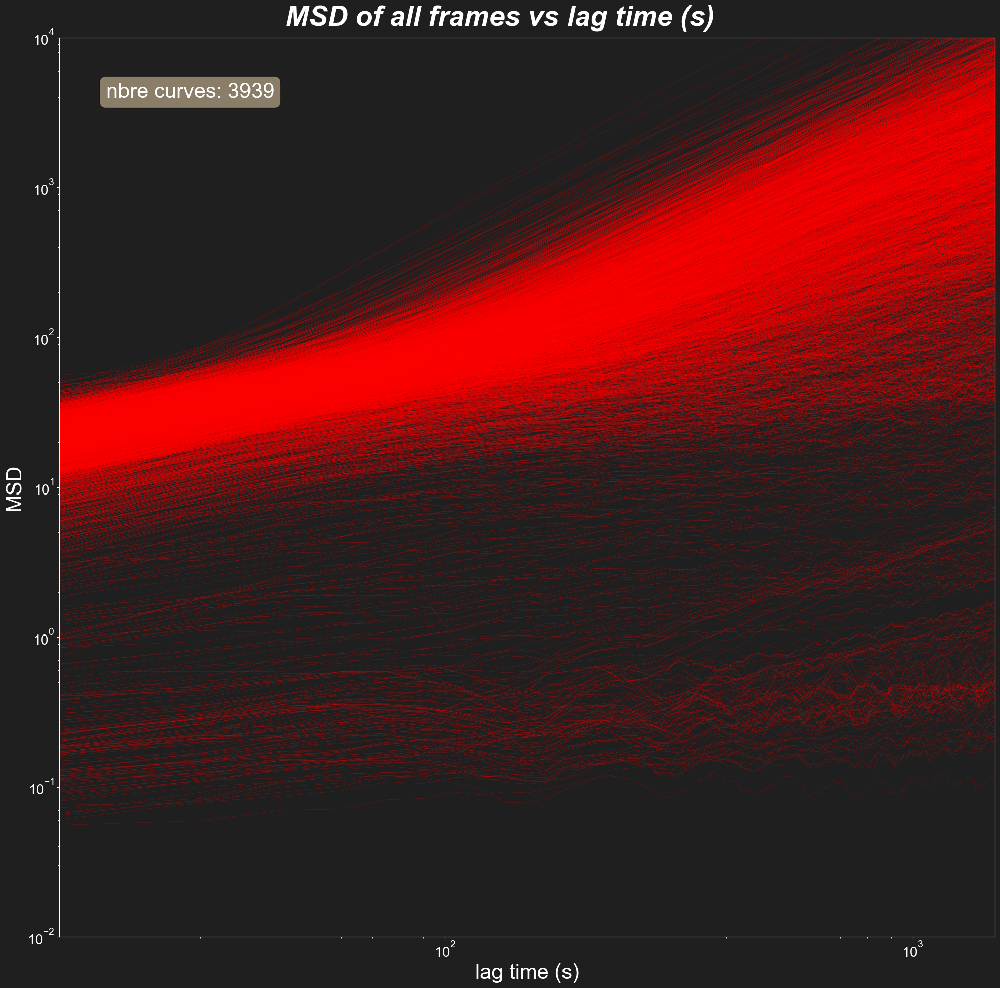

In [17]:
# Recompute MSD
DATA2 = DATA.copy()
DATA2['frame'] = pd.factorize(DATA2['frame'])[0]
IMSD = tp.imsd(traj=DATA2, mpp=SIZE_PIX, fps=FPS, max_lagtime=200, statistic='msd')

lib.plot_msd(IMSD, fps=FPS, name="MSD of all frames vs lag time (s)",
             color_plot='red', save=True, pathway_saving=path_save_pic,
             alpha=0.5, linewidth=0.3, img_type=IMG_TYPE)

Minimum local:  0.20000525952837656
# negative slope 0


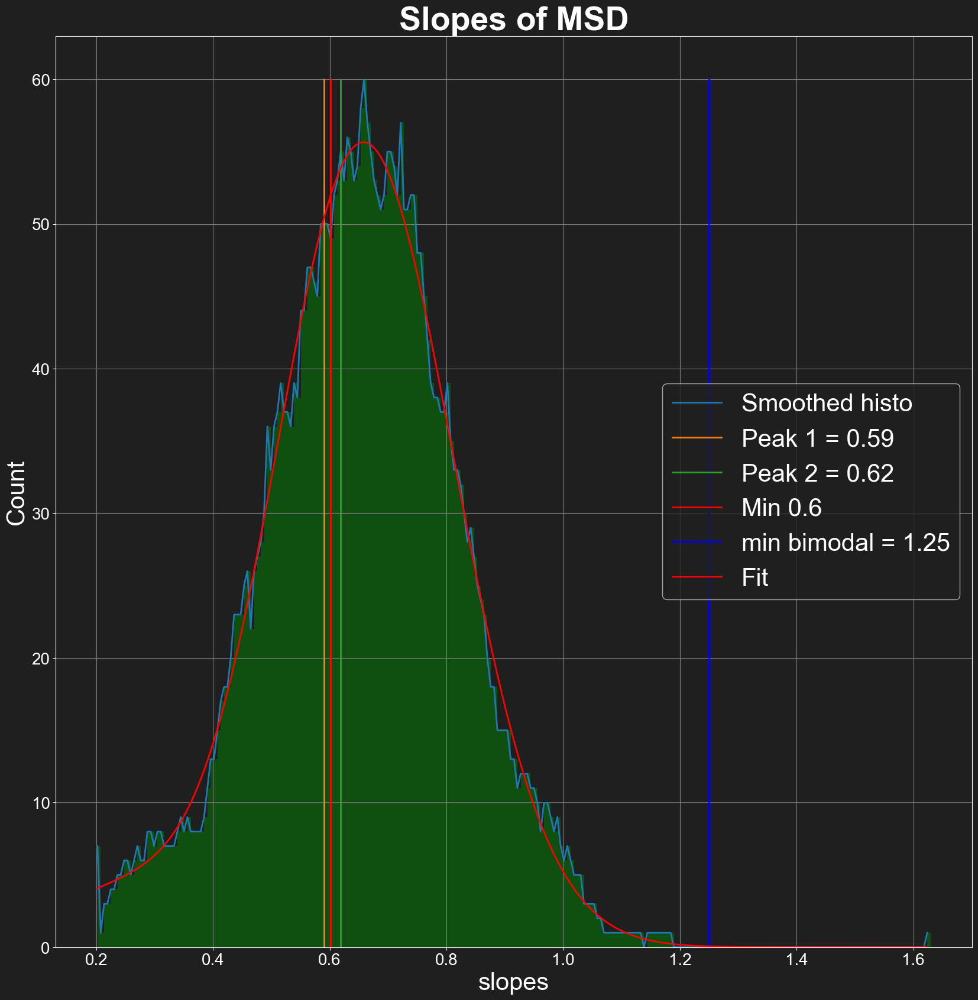

,index,y,x,mass,size,ecc,signal,raw_mass,ep,frame,...,dy [pix],displacement [pix],VitInst [um/min],time to incubation (hours),total_path_first_n,Xc [pix],Yc [pix],cumulative displacement [um],is_inf,is_sup
0,0,7943.292442,3107.937705,1082.656524,4.332735,0.315223,14.229878,27325.0,0.040951,0,...,NaN,NaN,NaN,53.50,454.229966,0.000000,0.000000,NaN,1,0
1,68156,5667.192980,990.777547,934.463152,3.804482,0.352358,18.960523,21602.0,0.114571,0,...,NaN,NaN,NaN,24.50,548.054260,0.000000,0.000000,NaN,1,0
2,891089,3057.100883,7437.952629,1365.682601,3.867015,0.320419,24.935055,23122.0,0.077053,0,...,NaN,NaN,NaN,30.00,284.567929,0.000000,0.000000,NaN,1,0
3,891429,57.662004,3368.572076,862.500093,4.166227,0.223091,12.180257,20796.0,0.127538,0,...,NaN,NaN,NaN,30.00,311.403265,0.000000,0.000000,NaN,1,0
4,891769,62.156392,4888.105289,708.293442,3.902299,0.194458,11.490809,20981.0,0.121221,0,...,NaN,NaN,NaN,30.00,310.496984,0.000000,0.000000,NaN,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1289164,298951,6716.896281,1775.921187,725.620090,3.246077,0.127752,17.453503,25865.0,3.406146,339,...,0.014652,0.070559,0.179784,0.00,61.684401,11.729961,0.039084,121.888197,1,0
1289165,791356,3735.712826,3957.434704,1111.765869,3.970687,0.293132,18.543806,21827.0,0.048417,339,...,-0.417920,12.298593,31.336816,1.67,585.817578,-132.748367,61.170277,823.293541,1,0
1289166,1675,8078.881194,2900.011255,934.234427,3.711918,0.243913,18.547409,22741.0,0.074893,339,...,3.411224,15.535672,39.584893,53.50,648.858396,53.212788,-78.152643,1523.349412,1,0
1289167,791899,52.476820,2252.954598,1601.494473,4.063505,0.361830,26.077975,23650.0,0.064881,339,...,0.315041,2.271492,5.787761,51.33,453.365202,84.534402,-2.388985,1106.326614,1,0


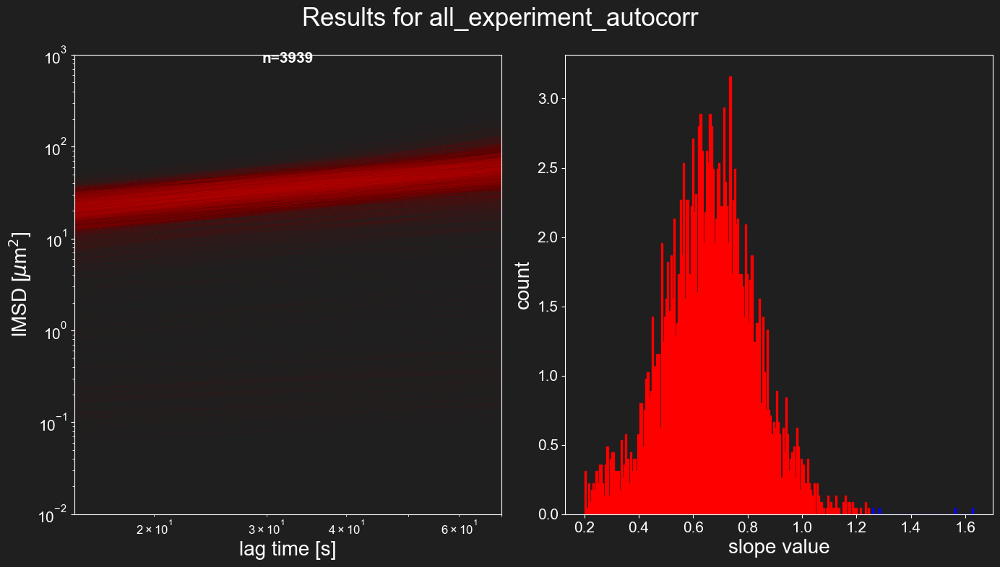

In [18]:
# Recompute trajectory clustering with new cutoff
LAG_TIME_FIT = 5
COEF_INF, COEF_SUP, PART_COEF_INF, PART_COEF_SUP, CUTOFF = lib.traj_clustering_with_fit_cutoff(
    DATA2, imsd=IMSD, hist=True, lag_time_fit=LAG_TIME_FIT, micronperpixel=SIZE_PIX,
    fps=FPS, binsize=250, peak_height=50, peak_width=1, save=True, pathway_fig=path_save_pic,
    name='all_experiment_autocorr', img_type=IMG_TYPE, plot=True, color_sup_inf=color_sup_inf,
    cutoff_default=1.25
)

# Ajouter les colonnes 'is_inf' et 'is_sup' à DATA
DATA['particle'] = DATA['particle'].astype(int)
PART_COEF_INF = set(map(int, PART_COEF_INF))
PART_COEF_SUP = set(map(int, PART_COEF_SUP))

# Ajout des colonnes 'is_inf' et 'is_sup'
DATA['is_inf'] = DATA['particle'].isin(PART_COEF_INF).astype(int)
DATA['is_sup'] = DATA['particle'].isin(PART_COEF_SUP).astype(int)
DATA

In [19]:
def calculate_metrics(DATA):
    # Calculer les vitesses moyennes instantanées pour toutes les particules
    mean_vitinst_df = DATA.groupby(['experiment', 'particle'])['VitInst [um/min]'].mean().reset_index()
    mean_vitinst_df = mean_vitinst_df.rename(columns={'VitInst [um/min]': 'mean_vit_inst'})

    # Calculer les médianes des vitesses instantanées pour toutes les particules
    median_vitinst_df = DATA.groupby(['experiment', 'particle'])['VitInst [um/min]'].median().reset_index()
    median_vitinst_df = median_vitinst_df.rename(columns={'VitInst [um/min]': 'median_vit_inst'})

    # Initialisation d'une liste pour stocker les résultats
    metrics = []

    # Parcours de chaque particule pour calculer les métriques
    for particle, group in DATA.groupby('particle'):
        experiment = group['experiment'].iloc[0]

        # Limiter aux 200 premières lignes
        limited_group = group.head(200)

        # Somme des déplacements (seulement sur les 200 premières lignes)
        displacement_sum = limited_group['displacement [pix]'].sum()

        # Récupérer la vitesse moyenne instantanée pré-calculée
        mean_vit_inst = mean_vitinst_df.loc[
            (mean_vitinst_df['experiment'] == experiment) & (mean_vitinst_df['particle'] == particle),
            'mean_vit_inst'
        ].values[0]

        # Récupérer la médiane des vitesses instantanées pré-calculée
        median_vit_inst = median_vitinst_df.loc[
            (median_vitinst_df['experiment'] == experiment) & (median_vitinst_df['particle'] == particle),
            'median_vit_inst'
        ].values[0]

        # Distance entre la position de départ et d'arrivée
        start_position = limited_group.iloc[0][['x', 'y']].values
        end_position = limited_group.iloc[-1][['x', 'y']].values
        start_end_distance = np.linalg.norm(end_position - start_position)

        # Stocker les résultats dans un dictionnaire
        metrics.append({
            'experiment': experiment,
            'particle': particle,
            'displacement_sum [um]': displacement_sum,
            'mean_vit_inst [um/min]': mean_vit_inst,
            'median_vit_inst [um/min]': median_vit_inst,
            'start_end_distance [um]': start_end_distance
        })

    # Conversion en DataFrame
    metrics_df = pd.DataFrame(metrics)
    return metrics_df

# Appel de la fonction pour obtenir le DataFrame consolidé
metrics_df = calculate_metrics(DATA)

# Affichage pour vérification
metrics_df

,experiment,particle,displacement_sum [um],mean_vit_inst [um/min],median_vit_inst [um/min],start_end_distance [um]
0,ASMOT192,0,1032.082151,14.501211,7.186751,61.627498
1,ASMOT192,1,1141.680394,15.156118,9.136395,57.956508
2,ASMOT192,2,1078.846438,13.931861,7.816365,44.147103
3,ASMOT192,3,969.238186,12.891927,7.122888,64.981006
4,ASMOT192,4,1352.756701,17.974624,10.033842,78.047558
...,...,...,...,...,...,...
3934,ASMOT194,4106,1149.493084,14.547717,6.545754,84.464863
3935,ASMOT194,4107,1273.196084,15.944458,6.913558,128.884144
3936,ASMOT194,4108,1043.183247,12.975688,6.186883,91.672434
3937,ASMOT194,4109,1026.201070,13.058686,7.491516,36.124379


In [20]:
def calculate_all_metrics(DATA):
    # Calculer le temps d'incubation et le nombre de particules (exp_hours)
    exp_hours = (
        DATA.groupby('experiment')
        .agg({
            'time to incubation (hours)': 'first',
            'particle': 'nunique'
        })
        .reset_index()
        .rename(columns={'particle': 'number_of_particles'})
    )

    # Compter les particules is_inf et is_sup
    particle_counts = (
        DATA.groupby(['experiment', 'particle'])
        .agg(
            is_inf=('is_inf', 'max'),
            is_sup=('is_sup', 'max')
        )
        .reset_index()
        .groupby('experiment')
        .agg(
            number_of_inf=('is_inf', 'sum'),
            number_of_sup=('is_sup', 'sum')
        )
        .reset_index()
    )
    particle_counts['proportion_inf'] = particle_counts['number_of_inf'] / (
        particle_counts['number_of_inf'] + particle_counts['number_of_sup']
    )

    # Calculer les métriques issues de metrics_df
    metrics_df = DATA.groupby(['experiment', 'particle']).apply(
        lambda group: {
            'displacement_sum [um]': group.head(200)['displacement [pix]'].sum(),
            'start_end_distance [um]': np.linalg.norm(
                group.head(200).iloc[0][['x', 'y']].values -
                group.head(200).iloc[-1][['x', 'y']].values
            ),
            'mean_vit_inst [um/min]': group['VitInst [um/min]'].mean()
        }
    ).apply(pd.Series).reset_index()

    result_metrics = metrics_df.groupby('experiment').agg(
        displacement_sum_mean=('displacement_sum [um]', 'mean'),
        start_end_distance_mean=('start_end_distance [um]', 'mean'),
        mean_speed=('mean_vit_inst [um/min]', 'mean')
    ).reset_index().rename(columns={
        'displacement_sum_mean': 'displacement_sum_mean [um]',
        'start_end_distance_mean': 'start_end_distance_mean [um]',
        'mean_speed': 'mean_speed [um/min]'
    })

    # Calculer taille et particules par champ
    spatial_metrics = DATA.groupby('experiment').apply(lambda group: {
        'taille': math.ceil(group['y'].max() / 2048) * math.ceil(group['x'].max() / 2048),
        'nombre_part_par_champs': group['particle'].nunique() /
        (math.ceil(group['y'].max() / 2048) * math.ceil(group['x'].max() / 2048)) if (
            math.ceil(group['y'].max() / 2048) * math.ceil(group['x'].max() / 2048)) > 0 else 0
    }).apply(pd.Series).reset_index()

    # Fusionner toutes les métriques
    consolidated_metrics = (
        exp_hours
        .merge(particle_counts, on='experiment', how='outer')
        .merge(result_metrics, on='experiment', how='outer')
        .merge(spatial_metrics, on='experiment', how='outer')
    )

    return consolidated_metrics

# Appel de la fonction
all_metrics_df = calculate_all_metrics(DATA)

# Affichage pour vérification
all_metrics_df

,experiment,time to incubation (hours),number_of_particles,number_of_inf,number_of_sup,proportion_inf,displacement_sum_mean [um],start_end_distance_mean [um],mean_speed [um/min],taille,nombre_part_par_champs
0,ASMOT184,0.00,81,81,0,1.000000,902.867879,42.203558,11.267968,12.0,6.750000
1,ASMOT185,0.00,69,69,0,1.000000,811.099349,29.867937,10.710117,9.0,7.666667
2,ASMOT186,0.00,71,71,0,1.000000,906.621962,56.274254,11.573079,9.0,7.888889
3,ASMOT187,24.00,176,176,0,1.000000,831.923498,108.335277,10.452771,12.0,14.666667
4,ASMOT188,26.50,153,153,0,1.000000,728.958155,92.250072,9.248565,12.0,12.750000
5,ASMOT189,30.00,162,162,0,1.000000,600.201331,26.109263,6.204936,12.0,13.500000
6,ASMOT190,47.75,58,57,1,0.982759,261.814980,27.312550,3.371888,12.0,4.833333
7,ASMOT191,51.33,199,197,2,0.989950,1020.205223,87.918710,13.120619,21.0,9.476190
8,ASMOT192,53.50,103,103,0,1.000000,982.598741,71.341942,12.727347,12.0,8.583333
9,ASMOT194,50.17,82,82,0,1.000000,1047.869389,66.720529,13.209389,16.0,5.125000


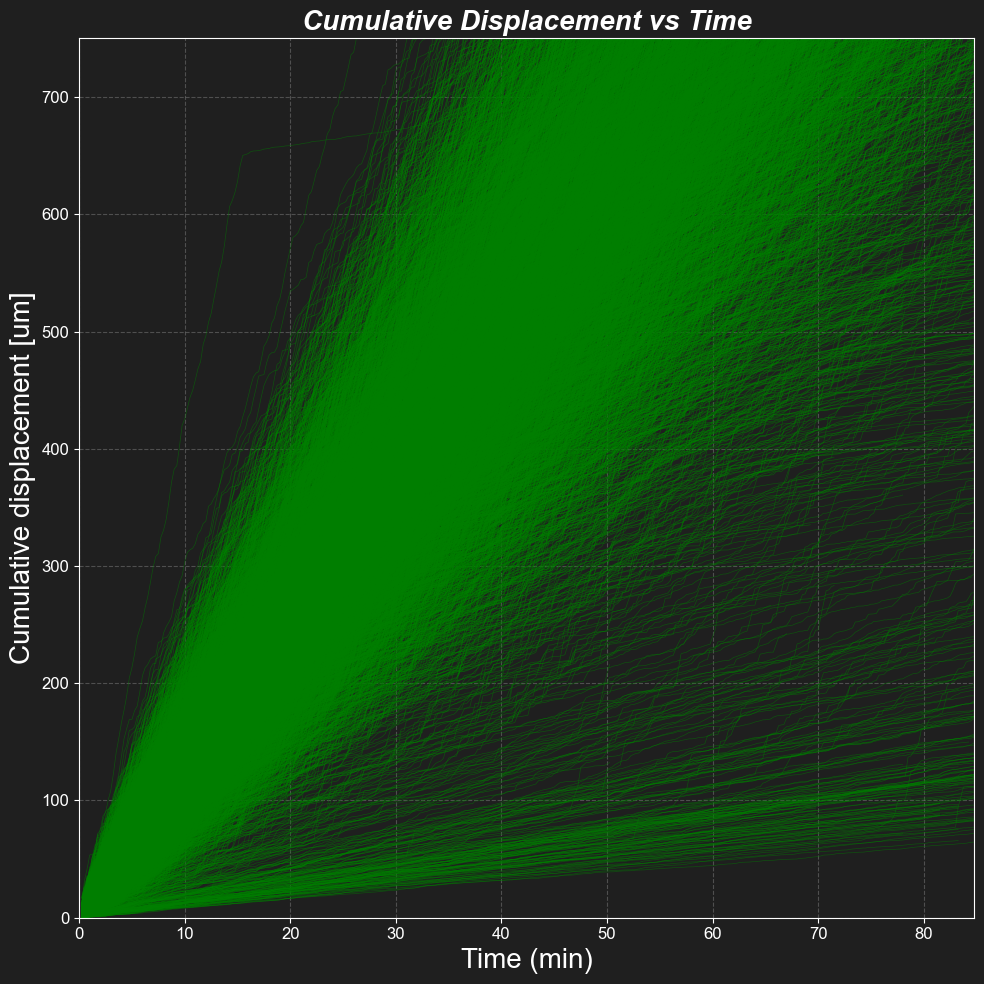

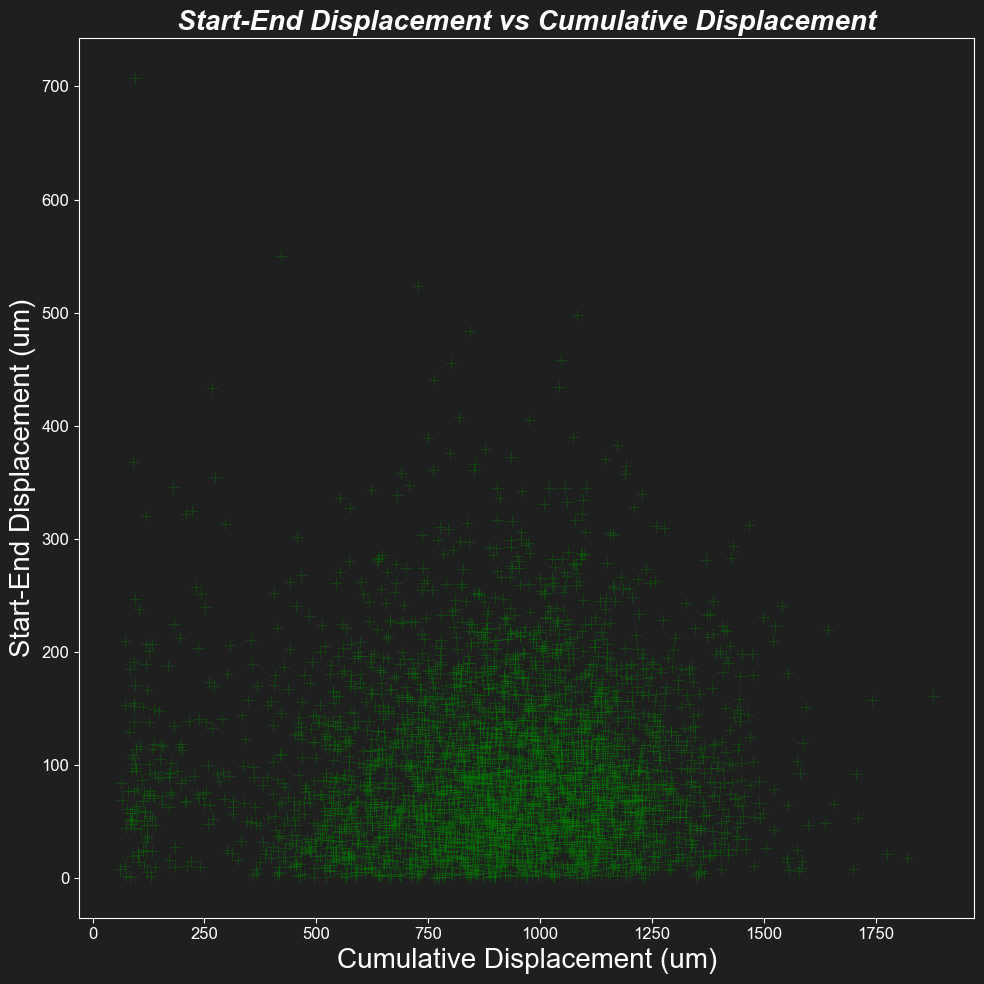

In [21]:
# Plot Displacement
lib.plot_displacement(
    DATA,
    start_end=metrics_df[['particle', 'start_end_distance [um]']],
    alpha=0.5,
    linewidth=0.5,
    ylim=[0, 750],
    xlim=[0, DATA['time (min)'].max()],
    save=True,
    pathway_saving=path_save_pic,
    name='displacement start-end all',
    img_type=IMG_TYPE
)

In [22]:

# Filtrer les particules appartenant à PART_COEF_INF
particle_distance_sup_df = metrics_df[metrics_df['particle'].isin(PART_COEF_SUP)][['start_end_distance [um]']]

# Affichage pour vérification
particle_distance_sup_df

,start_end_distance [um]
2028,20.539657
2445,440.596270
2589,97.245066
3342,707.161233


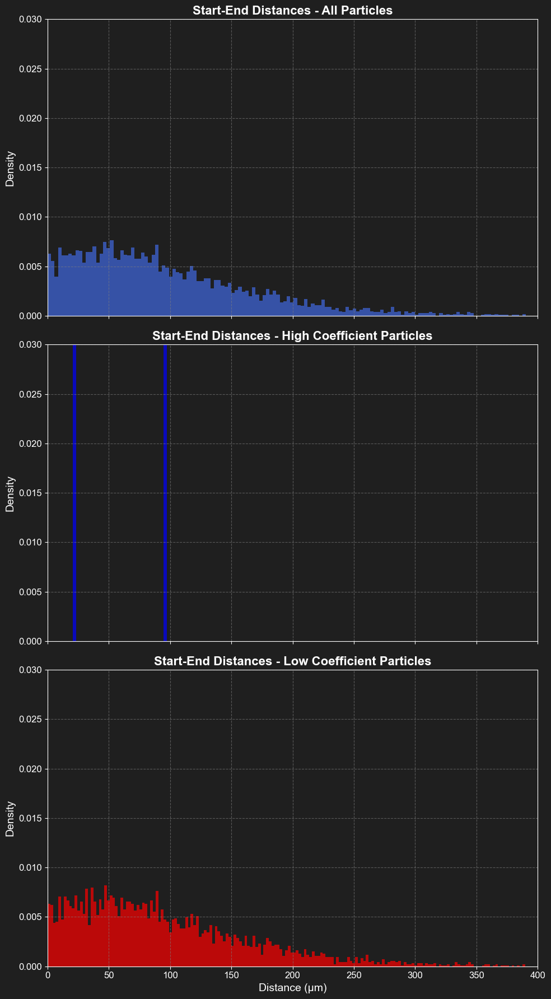

In [23]:
# Plot Histograms of Start-End Distances
def plot_histograms(start_end, PART_COEF_SUP, PART_COEF_INF):
    fig, axes = plt.subplots(3, 1, figsize=(10, 18), sharex=True, sharey=True)
    axes[0].hist(metrics_df['start_end_distance [um]'], bins=250, color='royalblue', alpha=0.7, density=True)
    axes[0].set_xlim([0, 400])
    axes[0].set_ylim([0, 0.03])
    axes[0].set_title('Start-End Distances - All Particles', fontsize=16)
    axes[0].set_ylabel('Density', fontsize=14)
    axes[0].grid(True, linestyle='--', alpha=0.6)

    axes[1].hist(metrics_df[metrics_df['particle'].isin(PART_COEF_SUP)][['start_end_distance [um]']], bins=250, color='blue', alpha=0.7, density=True)
    axes[1].set_xlim([0, 400])
    axes[1].set_title('Start-End Distances - High Coefficient Particles', fontsize=16)
    axes[1].set_ylabel('Density', fontsize=14)
    axes[1].grid(True, linestyle='--', alpha=0.6)

    axes[2].hist(metrics_df[metrics_df['particle'].isin(PART_COEF_INF)][['start_end_distance [um]']], bins=250, color='red', alpha=0.7, density=True)
    axes[2].set_xlim([0, 400])
    axes[2].set_title('Start-End Distances - Low Coefficient Particles', fontsize=16)
    axes[2].set_xlabel('Distance (μm)', fontsize=14)
    axes[2].set_ylabel('Density', fontsize=14)
    axes[2].grid(True, linestyle='--', alpha=0.6)

    plt.tight_layout()
    plt.savefig(os.path.join(path_save_pic, f"Nstart_end inf supp and all.{IMG_TYPE}"), format=IMG_TYPE)
    plt.show()

plot_histograms(start_end, PART_COEF_SUP, PART_COEF_INF)

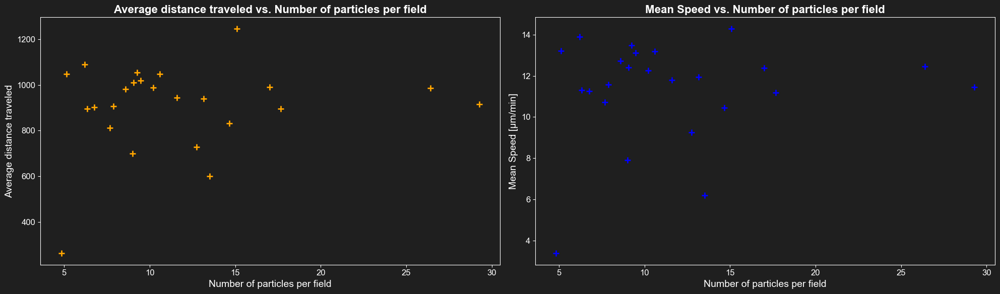

In [24]:
# Plot Results in Function of Number of Particles per Field
def plot_results_vs_particles(all_metrics_df, path_save_pic, CONDITION_simple):
    fig, axes = plt.subplots(1, 2, figsize=(20, 6))
    ax1, ax2 = axes.flatten()
    ax1.scatter(all_metrics_df['nombre_part_par_champs'], all_metrics_df['displacement_sum_mean [um]'], marker='+', color='orange')
    ax1.set_title('Average distance traveled vs. Number of particles per field')
    ax1.set_xlabel('Number of particles per field')
    ax1.set_ylabel('Average distance traveled')
    ax2.scatter(all_metrics_df['nombre_part_par_champs'], all_metrics_df['mean_speed [um/min]'], marker='+', color='blue')
    ax2.set_title('Mean Speed vs. Number of particles per field')
    ax2.set_xlabel('Number of particles per field')
    ax2.set_ylabel('Mean Speed [μm/min]')
    plt.tight_layout()
    plt.show()
    fig.savefig(os.path.join(path_save_pic, f"Results_vs_particles_{CONDITION_simple}.png"), format='png')

plot_results_vs_particles(all_metrics_df, path_save_pic, CONDITION_simple)

In [25]:
# Compute Angle Changes between Directions
def compute_angle_changes(DATA, PART_COEF_SUP, PART_COEF_INF):
    def angle_between_directions(row):
        dx1, dy1 = row['dir_x'], row['dir_y']
        dx2, dy2 = row['dir_x_next'], row['dir_y_next']
        angle_initial = np.arctan2(dy1, dx1)
        angle_final = np.arctan2(dy2, dx2)
        angle_change = angle_final - angle_initial
        angle_change = (angle_change + np.pi) % (2 * np.pi) - np.pi
        return np.degrees(angle_change)

    df_sup = DATA[DATA['particle'].isin(PART_COEF_SUP)].copy()
    df_sup.sort_values(by=['particle', 'frame'], inplace=True)
    df_sup['dir_x'] = df_sup.groupby('particle')['x'].diff().fillna(0)
    df_sup['dir_y'] = df_sup.groupby('particle')['y'].diff().fillna(0)
    df_sup['dir_x_next'] = df_sup.groupby('particle')['dir_x'].shift(-1)
    df_sup['dir_y_next'] = df_sup.groupby('particle')['dir_y'].shift(-1)
    df_sup['angle_change'] = df_sup.apply(angle_between_directions, axis=1)
    df_sup.dropna(subset=['dir_x_next', 'dir_y_next'], inplace=True)

    df_inf = DATA[DATA['particle'].isin(PART_COEF_INF)].copy()
    df_inf.sort_values(by=['particle', 'frame'], inplace=True)
    df_inf['dir_x'] = df_inf.groupby('particle')['x'].diff().fillna(0)
    df_inf['dir_y'] = df_inf.groupby('particle')['y'].diff().fillna(0)
    df_inf['dir_x_next'] = df_inf.groupby('particle')['dir_x'].shift(-1)
    df_inf['dir_y_next'] = df_inf.groupby('particle')['dir_y'].shift(-1)
    df_inf['angle_change'] = df_inf.apply(angle_between_directions, axis=1)
    df_inf.dropna(subset=['dir_x_next', 'dir_y_next'], inplace=True)

    return df_sup, df_inf

df_sup, df_inf = compute_angle_changes(DATA, PART_COEF_SUP, PART_COEF_INF)

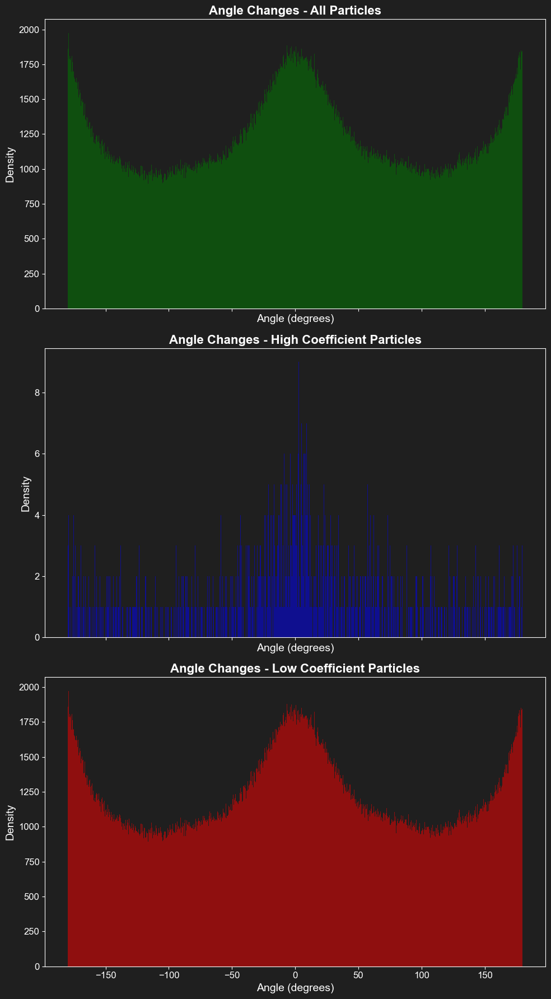

In [26]:
# Plot histograms of angle changes
def plot_angle_histograms(df_all, df_sup, df_inf):
    fig, axes = plt.subplots(3, 1, figsize=(10, 18), sharex=True)
    axes[0].hist(df_all['angle_change'], bins=1000, alpha=0.5, color='green')
    axes[0].set_title('Angle Changes - All Particles')
    axes[0].set_xlabel('Angle (degrees)')
    axes[0].set_ylabel('Density')

    axes[1].hist(df_sup['angle_change'], bins=1000, color='blue', alpha=0.5)
    axes[1].set_title('Angle Changes - High Coefficient Particles')
    axes[1].set_xlabel('Angle (degrees)')
    axes[1].set_ylabel('Density')

    axes[2].hist(df_inf['angle_change'], bins=1000, color='red', alpha=0.5)
    axes[2].set_title('Angle Changes - Low Coefficient Particles')
    axes[2].set_xlabel('Angle (degrees)')
    axes[2].set_ylabel('Density')

    plt.tight_layout()
    plt.show()
    
    fig.savefig(os.path.join(path_save_pic, 'Angle_Changes_Histograms.png'), format='png')

df_all = pd.concat([df_sup, df_inf])
plot_angle_histograms(df_all, df_sup, df_inf)

In [27]:
def plot_velocity_histograms(all_metrics_df, metrics_df, path_save_pic, img_type):
    """
    Plot histograms of mean instantaneous velocities for each experiment, sorted by incubation time.

    Parameters:
    - all_metrics_df (DataFrame): Aggregated metrics per experiment.
    - metrics_df (DataFrame): Metrics for each particle and experiment.
    - path_save_pic (str): Path where the plot will be saved.
    - img_type (str): Image format for saving the plot.
    """
    exp_hours = all_metrics_df[['experiment', 'time to incubation (hours)']].sort_values(by='time to incubation (hours)')
    experiments = exp_hours['experiment'].tolist()
    incubation_times = exp_hours['time to incubation (hours)'].tolist()

    global_min = metrics_df['mean_vit_inst [um/min]'].min()
    global_max = metrics_df['mean_vit_inst [um/min]'].max()
    delta = (global_max - global_min) * 0.1
    global_min -= delta
    global_max += delta

    n_experiments = len(experiments)
    fig, axes = plt.subplots(nrows=n_experiments, ncols=1, figsize=(10, 3 * n_experiments), sharex=True, sharey=True)
    if n_experiments == 1:
        axes = [axes]
    palette = colormaps['tab20']
    colors = [palette(i / n_experiments) for i in range(n_experiments)]

    for idx, ax in enumerate(axes):
        exp = experiments[idx]
        hour = incubation_times[idx]
        data_exp = metrics_df[metrics_df['experiment'] == exp]
        ax.hist(data_exp['mean_vit_inst [um/min]'], bins=30, alpha=0.3, range=(global_min, global_max), color=colors[idx])
        ax.set_title(f'Vit. Inst. Moyenne [μm/min] - {exp} (Incubation: {hour}h)')
        ax.set_xlabel('VitInst [μm/min]')
        ax.set_ylabel('Nombre de particules')

        median_value = all_metrics_df.loc[all_metrics_df['experiment'] == exp, 'mean_speed [um/min]'].values[0]
        ax.axvline(median_value, color='red', linestyle='dashed', linewidth=1)
        ax.text(
            median_value + 0.05 * (global_max - global_min), 
            ax.get_ylim()[1] * 0.95,
            f'Médiane: {median_value:.2f}',
            color='red',
            ha='left'
        )
        ax.set_xlim(global_min, global_max)

    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, f'Velocity_Histograms.{img_type}')
    fig.savefig(fig_path, format=img_type)
    plt.show()
    print(f"Plot saved to {fig_path}")

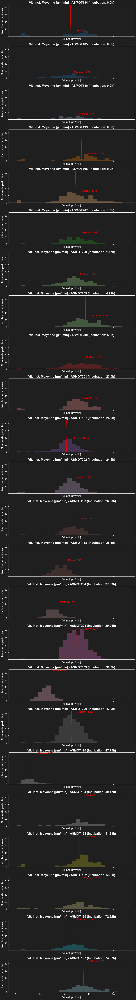

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_SorC_10x_results_tracking_All/Velocity_Histograms.svg


In [28]:
# plot_velocity_histograms(all_mean_vitinst, medians, exp_hours, path_save_pic, IMG_TYPE)
plot_velocity_histograms(all_metrics_df, metrics_df, path_save_pic, IMG_TYPE)

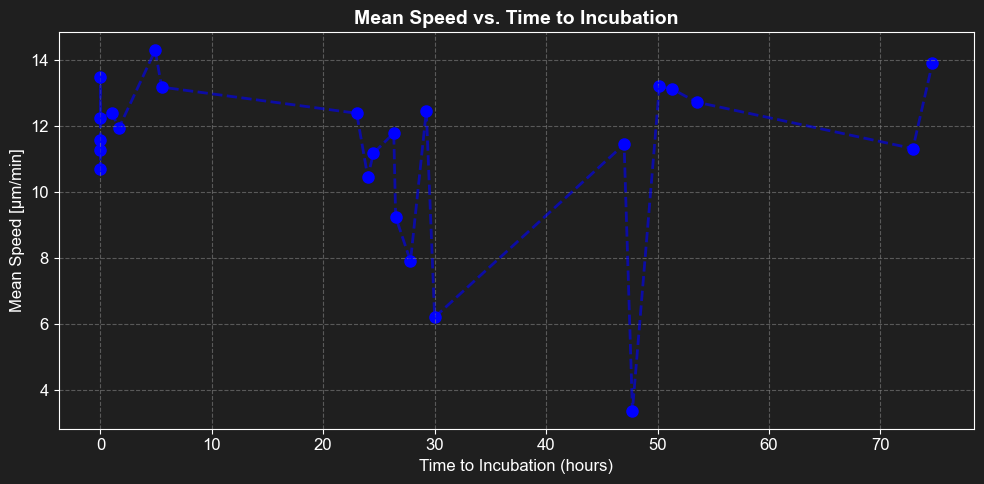

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_SorC_10x_results_tracking_All/Mean_Speed_vs_Time.png


In [29]:
def plot_median_velocity_vs_time(all_metrics_df, path_save_pic):
    """
    Plot median velocities as a function of incubation time using all_metrics_df.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
    - path_save_pic (str): Path where the plot will be saved.
    """
    # Trier les données par temps d'incubation
    all_metrics_sorted = all_metrics_df.sort_values(by='time to incubation (hours)')

    # Préparer le tracé
    plt.figure(figsize=(10, 5))
    plt.scatter(all_metrics_sorted['time to incubation (hours)'], 
                all_metrics_sorted['mean_speed [um/min]'],  # Correction de la colonne utilisée
                color='blue', label='Médiane')
    plt.plot(all_metrics_sorted['time to incubation (hours)'], 
             all_metrics_sorted['mean_speed [um/min]'],  # Correction de la colonne utilisée
             linestyle='--', color='blue', alpha=0.6)

    # Ajouter des labels et des titres
    plt.title('Mean Speed vs. Time to Incubation', fontsize=14)
    plt.xlabel('Time to Incubation (hours)', fontsize=12)
    plt.ylabel('Mean Speed [μm/min]', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)

    # Sauvegarder et afficher
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, 'Mean_Speed_vs_Time.png')
    plt.savefig(fig_path, format='png')
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction corrigée
plot_median_velocity_vs_time(all_metrics_df, path_save_pic)

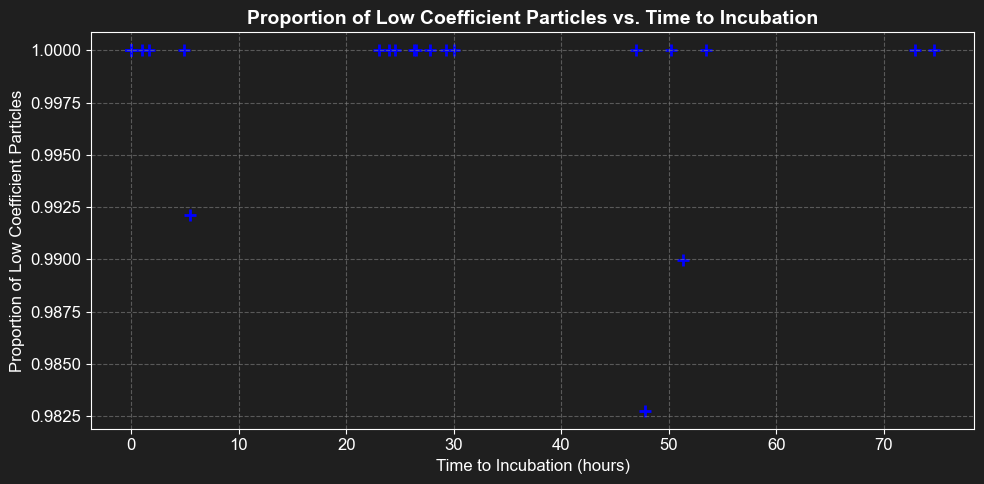

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_SorC_10x_results_tracking_All/Proportion_Low_Coeff_Particles_vs_Time.svg


In [30]:
def plot_proportion_vs_time(all_metrics_df, path_save_pic, img_type):
    """
    Plot the proportion of low coefficient particles (proportion_inf) vs. time to incubation.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
    - path_save_pic (str): Path where the plot will be saved.
    - img_type (str): Image format for saving the plot.
    """
    # Trier les données par temps d'incubation
    all_metrics_sorted = all_metrics_df.sort_values(by='time to incubation (hours)')

    # Préparer le tracé
    plt.figure(figsize=(10, 5))
    plt.scatter(all_metrics_sorted['time to incubation (hours)'], 
                all_metrics_sorted['proportion_inf'], 
                color='blue', marker='+', label='Proportion inf')
    
    # Ajouter des titres et des labels
    plt.title('Proportion of Low Coefficient Particles vs. Time to Incubation', fontsize=14)
    plt.xlabel('Time to Incubation (hours)', fontsize=12)
    plt.ylabel('Proportion of Low Coefficient Particles', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)

    # Ajuster et sauvegarder
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, f'Proportion_Low_Coeff_Particles_vs_Time.{img_type}')
    plt.savefig(fig_path, format=img_type)
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction
plot_proportion_vs_time(all_metrics_df, path_save_pic, IMG_TYPE)

/var/folders/sk/m9jkmr4n1k5dqc3wj_f53p4r0000gp/T/ipykernel_54950/1054111647.py:16: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  proportion_per_bin_inf = all_metrics_df.groupby('time_bin')['proportion_inf'].mean()


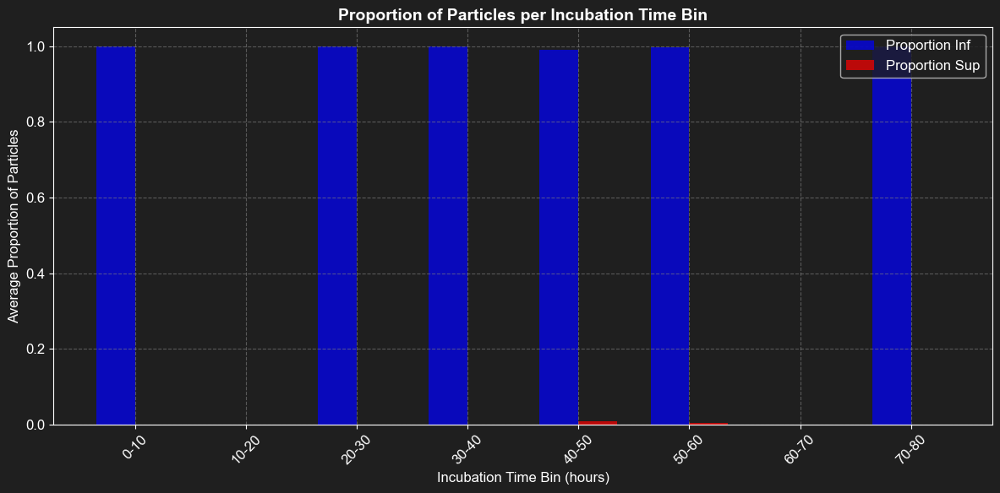

Plot saved to /Users/souchaud/Desktop/Analyses/résultats_CytoOne_SorC_10x_results_tracking_All/Proportion_vs_Time_Bins.svg


In [31]:
def plot_proportion_per_time_bins(all_metrics_df, path_save_pic, img_type):
    """
    Plot proportions of particles (Inf and Sup) per incubation time bins.

    Parameters:
    - all_metrics_df (DataFrame): DataFrame containing aggregated metrics for each experiment.
    - path_save_pic (str): Path where the plot will be saved.
    - img_type (str): Image format for saving the plot.
    """
    # Définir les intervalles de temps d'incubation
    bins = np.arange(0, all_metrics_df['time to incubation (hours)'].max() + 10, 10)
    labels = [f"{int(left)}-{int(right)}" for left, right in zip(bins[:-1], bins[1:])]
    all_metrics_df['time_bin'] = pd.cut(all_metrics_df['time to incubation (hours)'], bins=bins, labels=labels, right=False)

    # Calculer les proportions moyennes pour chaque bin
    proportion_per_bin_inf = all_metrics_df.groupby('time_bin')['proportion_inf'].mean()
    proportion_per_bin_sup = 1 - proportion_per_bin_inf

    # Configuration des barres pour le tracé
    x = np.arange(len(proportion_per_bin_inf))
    width = 0.35

    # Tracé des proportions
    fig, ax = plt.subplots(figsize=(12, 6))
    ax.bar(x - width/2, proportion_per_bin_inf, width, color='blue', alpha=0.7, label='Proportion Inf')
    ax.bar(x + width/2, proportion_per_bin_sup, width, color='red', alpha=0.7, label='Proportion Sup')
    ax.set_title('Proportion of Particles per Incubation Time Bin', fontsize=14)
    ax.set_xlabel('Incubation Time Bin (hours)', fontsize=12)
    ax.set_ylabel('Average Proportion of Particles', fontsize=12)
    ax.set_xticks(x)
    ax.set_xticklabels(labels, rotation=45)
    ax.legend()
    plt.grid(True, linestyle='--', alpha=0.6)

    # Sauvegarder et afficher le graphique
    plt.tight_layout()
    fig_path = os.path.join(path_save_pic, f'Proportion_vs_Time_Bins.{img_type}')
    plt.savefig(fig_path, format=img_type)
    plt.show()

    print(f"Plot saved to {fig_path}")

# Appel de la fonction
plot_proportion_per_time_bins(all_metrics_df, path_save_pic, IMG_TYPE)

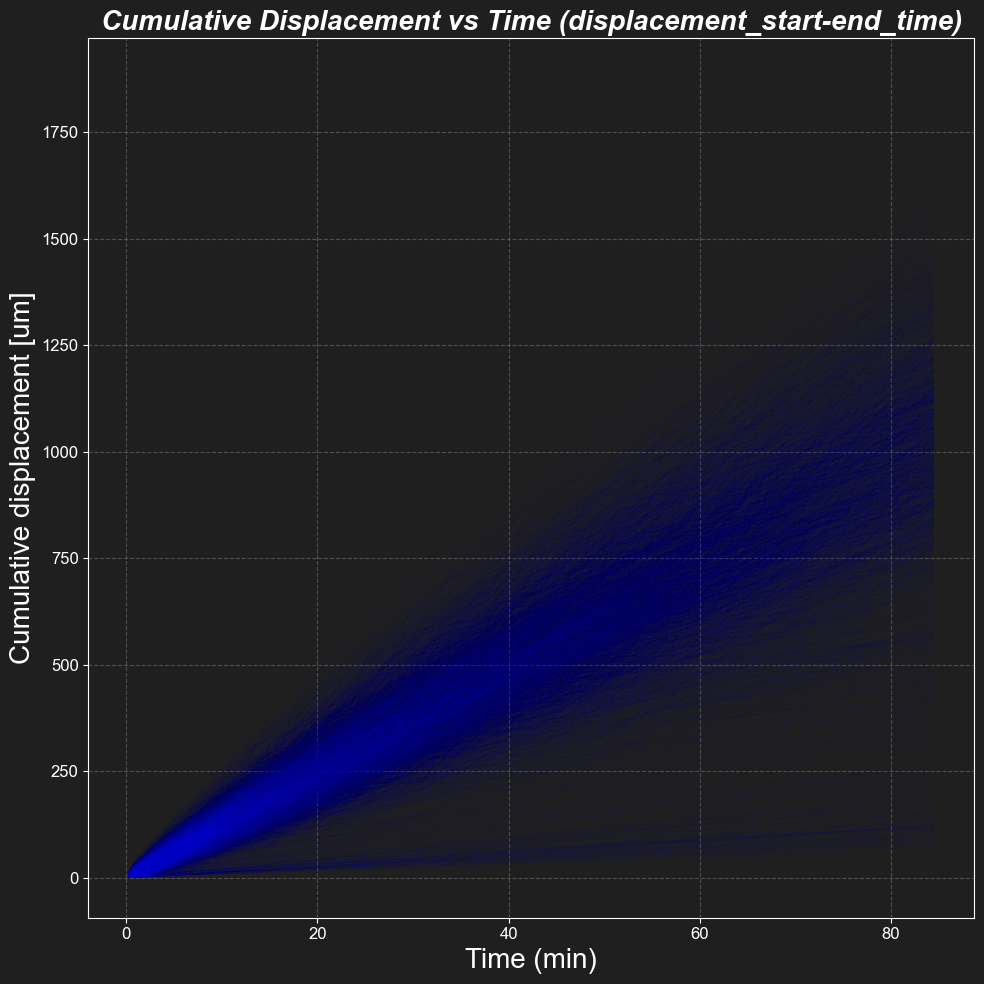

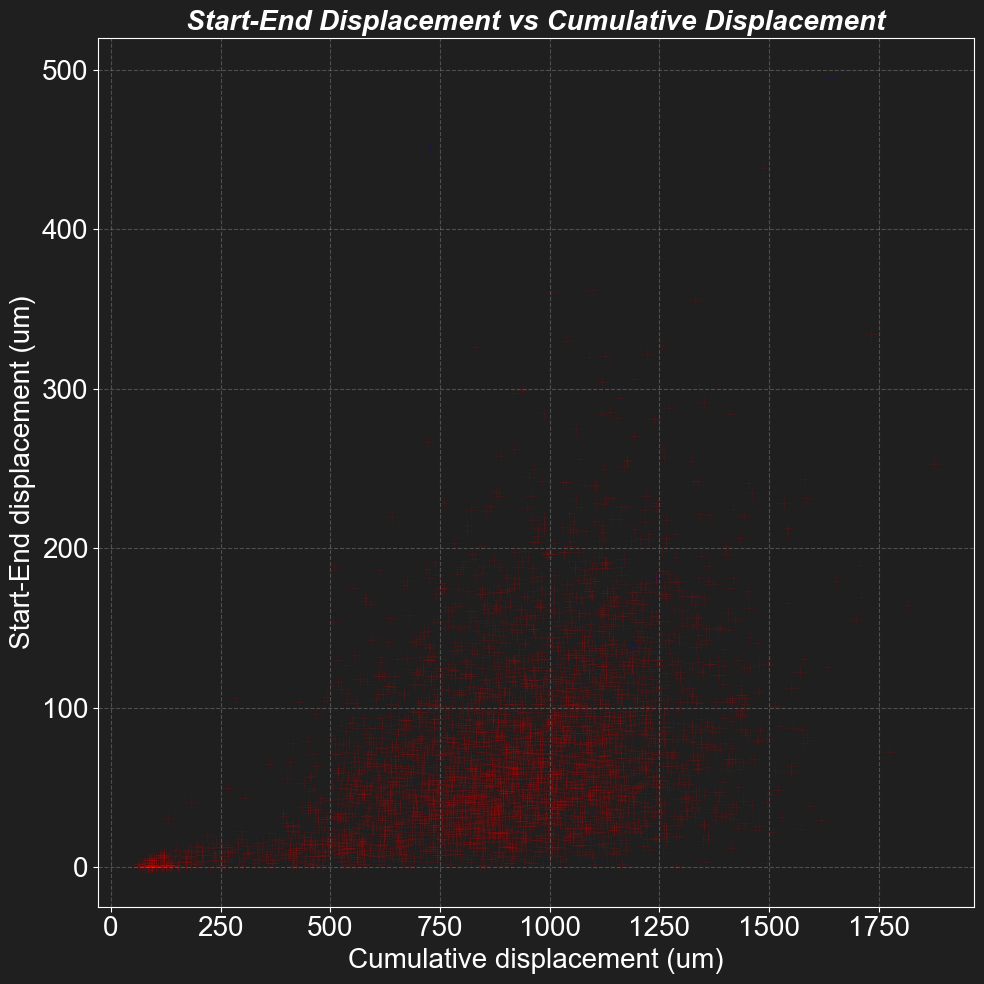

In [32]:
# Plot displacement comparison between low and high coefficient particles
lib.plot_displacement_low_and_high(
    traj_sup=df_sup,
    traj_inf=df_inf,
    part_coef_inf=PART_COEF_INF,
    part_coef_sup=PART_COEF_SUP,
    start_end=start_end,
    save=True,
    pathway_saving=path_save_pic,
    name="displacement_start-end_time",
    img_type=IMG_TYPE
)

Il y'a plusieurs choses qui ne vont pas : Les temps Nan dans unique particles, n'ont pas de sens. Il y'a des endroits ou on ne prends pas en compte les manips au temps 0. 


df_inf est pas complet pour calculer les unique_...